In [1]:
import rasterio as rio
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import json
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from rasterio.enums import Resampling
from PIL import ImageColor
from skimage.exposure import rescale_intensity

In [2]:
# Location of data
lc_dir = 'data/lc.json'
lc_image_dir = 'https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/LC_Image_v1.tif'
palsar_dir = "https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/Palsar_Kerinci_2023_v1.tif"
landsat_dir = "https://storage.googleapis.com/gee-ramiqcom-bucket/youtube/lc_python/Landsat_Kerinci_2023_v1.tif"

In [3]:
# Load Land Cover Parameter
lc = json.load(open(lc_dir))
lc_df = pd.DataFrame(lc)
lc_df["values_normalize"] = lc_df.index + 1
lc_df["palette"] = "#" + lc_df["palette"]

# Mapping from old to new values
values = lc_df["values"].to_list()
values_norm = lc_df["values_normalize"].to_list()
palette = lc_df["palette"].to_list()
labels = lc_df["label"].to_list()
dict_values = {}
dict_label = {}
dict_palette = {}
dict_palette_hex = {}
for x in range(0, len(values)):
    dict_values[values[x]] = values_norm[x]
    dict_label[values_norm[x]] = labels[x]
    dict_palette[values_norm[x]] = ImageColor.getrgb(palette[x])
    dict_palette_hex[values_norm[x]] = palette[x]

# Create colormap from values and palette
cmap = ListedColormap(palette)

# Patches legend
patches = [
    mpatches.Patch(color=palette[i], label=labels[i]) for i in range(len(values))
]
legend = {
    "handles": patches,
    "bbox_to_anchor": (1.05, 1),
    "loc": 2,
    "borderaxespad": 0.0,
}

lc_df

,palette,values,label,values_normalize
0,#006400,2001,Primary dryland forest,1
1,#228B22,2002,Secondary dryland forest,2
2,#4B0082,2004,Primary mangrove forest,3
3,#808000,2005,Primary swamp forest,4
4,#32CD32,2006,Plantation forest,5
5,#90EE90,2007,Dry shrub,6
6,#FF4500,2010,Estate crop,7
7,#F08080,2012,Settlement,8
8,#D2B48C,2014,Bare ground,9
9,#ADFF2F,3000,Savanna and grasses,10


In [4]:
# Load land cover image
lc_source = rio.open(lc_image_dir)
lc_image = lc_source.read()[0]

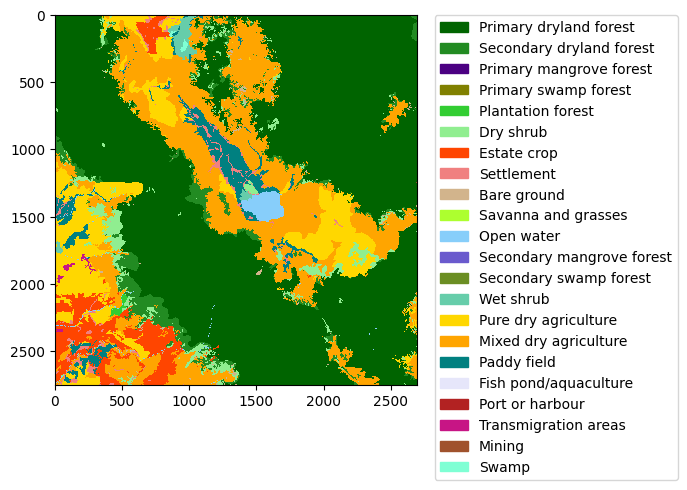

In [5]:
# Remap LC image data
for x in range(0, len(lc_df)):
	lc_dict = lc_df.loc[x]
	lc_image[lc_image == lc_dict['values']] = lc_dict['values_normalize']

# Show the land cover
plt.imshow(lc_image, cmap=cmap, interpolation='nearest')
plt.legend(**legend)

In [ ]:
# Load satellite imagery
landsat = rio.open(landsat_dir)
landsat_image = landsat.read() / 1e4

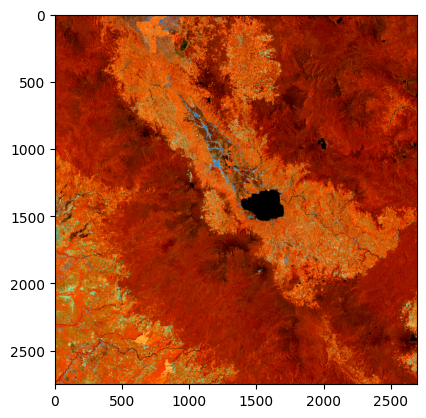

In [7]:
# Create a composite
composite = np.dstack([
	rescale_intensity(landsat_image[4], in_range=(0.125, 0.4), out_range=(0, 1)),
	rescale_intensity(landsat_image[5], in_range=(0.1, 0.3), out_range=(0, 1)),
	rescale_intensity(landsat_image[6], in_range=(0.075, 0.2), out_range=(0, 1))
])

# Visualize composite
plt.imshow(composite)

In [8]:
# Calculate unique values in the land cover
uniques = np.unique(lc_image)
uniques

array([ 1,  2,  5,  6,  7,  8,  9, 11, 14, 15, 16, 17, 20, 21, 22],
      dtype=int32)

c:\Users\ramiq\Scripts\deep-learning-lc\.venv\lib\site-packages\rasterio\__init__.py:377: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = writer(


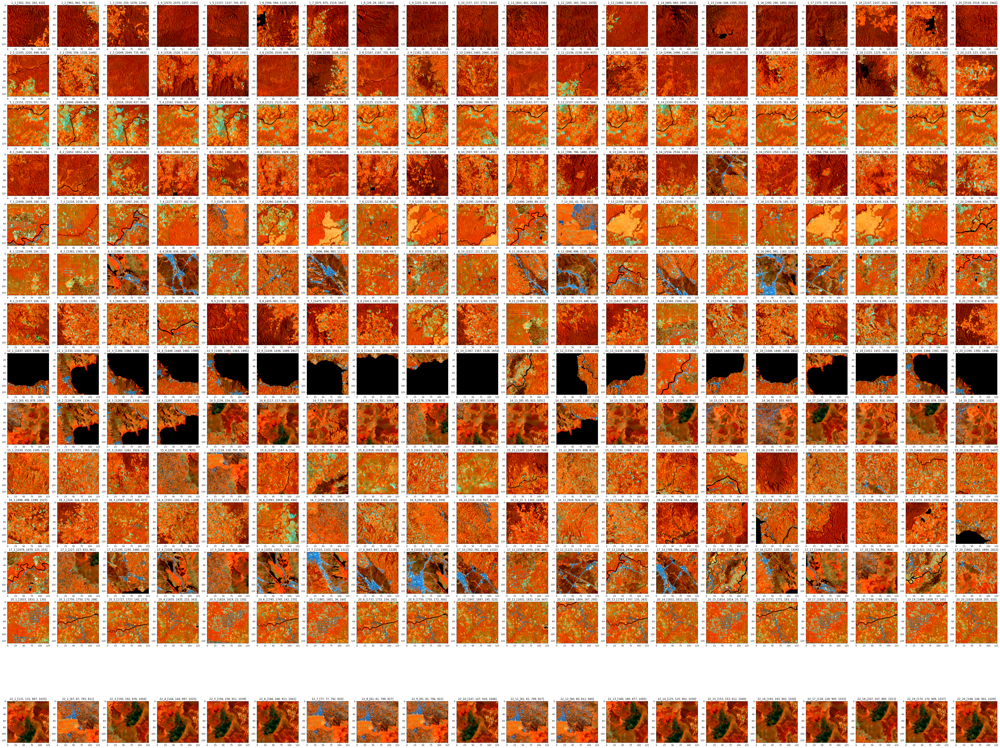

In [ ]:
# Width/height of the new image
image_width = 128

# Define image per land cover
image_per_lc = 20

plt.figure(figsize=(4 * image_per_lc, 4 * len(uniques)))

# Get the land cover clip using the the width
for x in range(0, len(uniques)):
	lc = uniques[x]

	coords = np.argwhere(lc_image == lc)
	coords_filter = []

	# Coordinate
	for c in coords:
		cond1 = (c[0] - (image_width / 2)) >= 0
		cond2 = (c[1] - (image_width / 2)) >= 0
		cond3 = (c[0] + (image_width / 2)) <= lc_image.shape[0]
		cond4 = (c[1] + (image_width / 2)) <= lc_image.shape[1]

		if (cond1 & cond2 & cond3 & cond4):
			coords_filter.append(c)

	if (len(coords_filter) > 0):
		seq = np.arange(len(coords_filter) - 1)
		sample = np.random.choice(seq, size=image_per_lc)
		sample_coord = list(map(lambda x: coords_filter[x], sample))

		for y in range(0, len(sample_coord)):
			# Coordinate
			coord = sample_coord[y]

			# Min max of the coordinate
			max_y = int(coord[0] + (image_width / 2))
			min_y = int(coord[0] - (image_width / 2))
			max_x = int(coord[1] + (image_width / 2))
			min_x = int(coord[1] - (image_width / 2))

			# Get the image using the coordinate with
			lc_coord = lc_image[min_y:max_y, min_x:max_x]
			image_coord = composite[min_y:max_y, min_x:max_x]
			image_coord_t = np.transpose(image_coord, (2, 0, 1))

			id = f'{lc}_{y + 1}'

			# Save image as tiff
			output = rio.open(
				f'data/images/{id}.tif',
				'w',
				'GTiff',
				count=image_coord_t.shape[0],
				width=image_coord_t.shape[2],
				height=image_coord_t.shape[1],
				dtype='float32',
				compress='lzw',
				resampling=Resampling.nearest,
			)
			output.write(image_coord_t)
			output.close()

			# Save lc
			output = rio.open(
				f'data/lcs/{id}.tif',
				'w',
				'GTiff',
				count=1,
				width=lc_coord.shape[1],
				height=lc_coord.shape[0],
				dtype='uint8',
				compress='lzw',
				resampling=Resampling.nearest,
			)
			output.write(lc_coord, 1)
			output.write_colormap(1, dict_palette)
			output.close()

			# Plot the preview image
			plt.subplot(len(uniques), image_per_lc, x * image_per_lc + y + 1)
			plt.imshow(image_coord)
			plt.title(f'{lc}_{y + 1}_[{min_y}, {min_y}, {min_x}, {max_x}]')

			# plt.subplot(len(uniques), image_per_lc, x * image_per_lc + y + 1)
			# plt.imshow(lc_coord, cmap=cmap, interpolation='nearest', vmin=1, vmin=22)
			# plt.title(f'{lc}_{y + 1}_[{min_y}, {min_y}, {min_x}, {max_x}]')